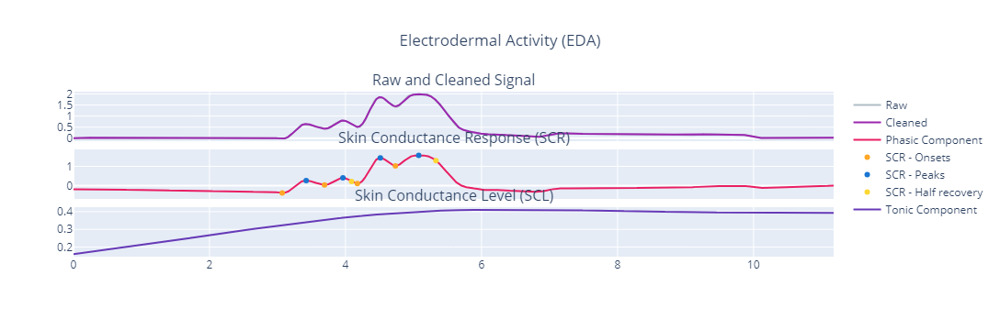

In [4]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import neurokit2 as nk
import seaborn as sns
from datetime import datetime

df= pd.read_excel(open(r'C:\temp\EDA.xlsx','rb'),sheet_name='Sheet1')
#df= pd.read_excel(open(r'C:\temp\S01.xlsx', 'rb'),sheet_name='sheet1')
#sheet_to_df_map['Midterm1']=df

eda_data=df['EDA']
eda_clean1 = nk.eda_clean(eda_data, sampling_rate=4000, method='neurokit')
signals,info = nk.eda_process(eda_clean1 ,sampling_rate=4000)
nk.eda_plot(signals,info,static=False)



<Axes: >

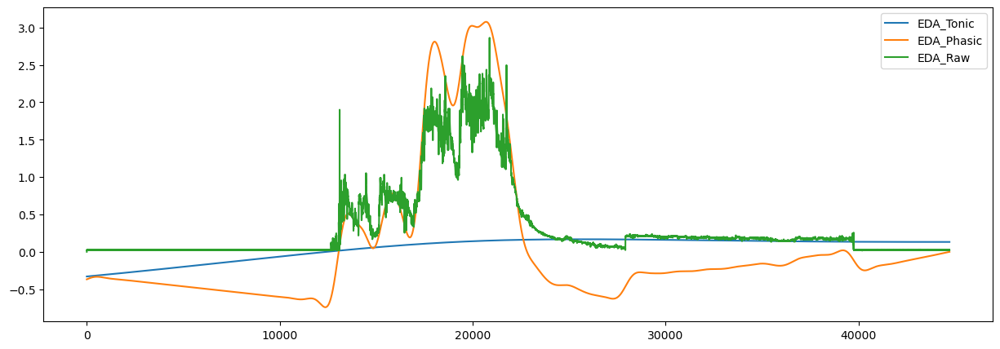

In [59]:
plt.rcParams['figure.figsize'] = [15, 5]  # Bigger images
data = nk.eda_phasic(nk.standardize(eda_clean1),sampling_rate=4000)
data["EDA_Raw"]=eda_data  # Add raw signal
data.plot()

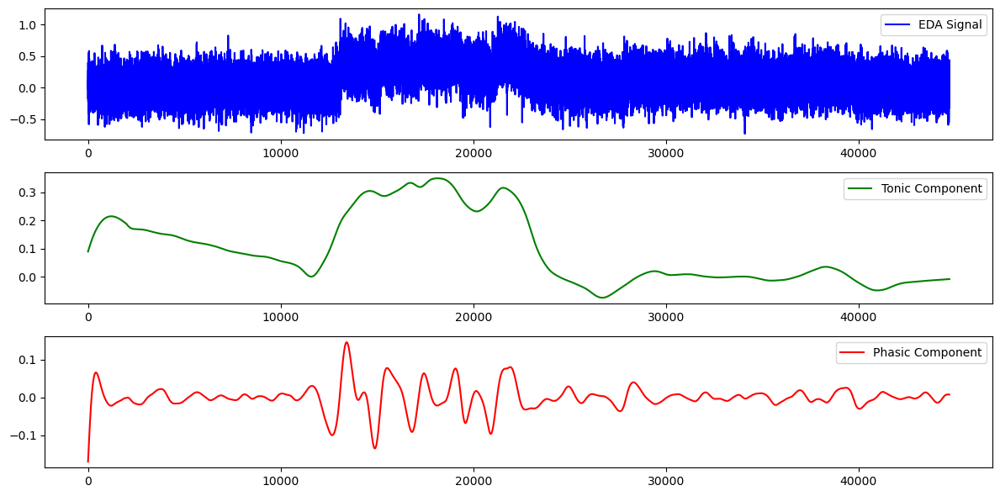

In [63]:
import numpy as np
import scipy.signal as signal
import matplotlib.pyplot as plt

def separate_tonic_phasic(eda_signal, sampling_rate):
    # Bandpass filter parameters
    lowcut = 0.04  # Lower cutoff frequency in Hz
    highcut = 4.0  # Upper cutoff frequency in Hz

    # Design a Butterworth bandpass filter
    nyquist = 0.5 * sampling_rate
    low = lowcut / nyquist
    high = highcut / nyquist
    b, a = signal.butter(2, [low, high], btype='band')

    # Apply the bandpass filter to the EDA signal
    filtered_signal = signal.filtfilt(b, a, eda_signal)

    # Calculate the tonic component using a moving average
    window_length = int(sampling_rate * 1.0)  # 1-second window
    tonic_component = signal.savgol_filter(filtered_signal, window_length, 3)

    # Calculate the phasic component by subtracting the tonic component
    phasic_component = filtered_signal - tonic_component

    return tonic_component, phasic_component

eda_signal = 0.5 * np.sin(2 * np.pi * 0.2 * eda_data) + np.random.normal(0, 0.2, len(eda_data))

# Separate tonic and phasic components
tonic,phasic= separate_tonic_phasic(eda_signal,sampling_rate=4000)

# Plot the original EDA signal, tonic, and phasic components
plt.figure(figsize=(12, 6))
plt.subplot(3, 1, 1)
plt.plot(eda_signal, 'b', label='EDA Signal')
plt.legend(loc='best')
plt.subplot(3, 1, 2)
plt.plot(tonic, 'g', label='Tonic Component')
plt.legend(loc='best')
plt.subplot(3, 1, 3)
plt.plot(eda_data,phasic, 'r', label='Phasic Component')
plt.legend(loc='best')
plt.tight_layout()
plt.show()




In [2]:
import pandas as pd
from datetime import datetime
from datetime import timedelta
df
# Define start and end timestamps
start_timestamp =EDA_time.iloc[0]  # Replace with your actual start timestamp
end_timestamp = EDA_time.iloc[-1] # Replace with your actual end timestamp

start = pd.to_datetime(start_timestamp, infer_datetime_format=True)
end = pd.to_datetime(end_timestamp, infer_datetime_format=True)

# Calculate the time difference in seconds
time_difference_seconds = (end-start).total_seconds()

T=time_difference_seconds/60

Tw=[5,15,30]

#first five minutes
First5_end=start+timedelta(minutes=5)

dfs_F= df[(df['EDA_time'] >= start) & (df['EDA_time'] <= First5_end)]

print("First 5min mean: ",dfs_F['EDA'].mean())
print("First 5min variance: ",dfs_F['EDA'].std())
print("MID 5min variance: ",dfs_M['EDA'].std())




#middle five minutes
mid=T/2
Midtime=start+timedelta(minutes=mid)
Mid5_start=Midtime-timedelta(minutes=2.5)
Mid5_end=Midtime+timedelta(minutes=2.5)
dfs_M= df[(df['EDA_time'] >= Mid5_start) & (df['EDA_time'] <= Mid5_end)]
print("MID 5min mean: ",dfs_M['EDA'].mean())
print("MID 5min variance: ",dfs_M['EDA'].std())
print("MID 5min variance: ",dfs_M['EDA'].std())




#last Five minutes
last5_start=end-timedelta(minutes=5)
dfs_l= df[(df['EDA_time'] >= last5_start) & (df['EDA_time'] <= end)]
print("Last 5min mean: ",dfs_l['EDA'].mean())
print("Last 5min variance: ",dfs_l['EDA'].std())




NameError: name 'df' is not defined

In [20]:
from datetime import datetime
from datetime import timedelta
df=pd.read_excel(r"C:\Numpyninja\Datathon Sep\Data\Data\S9\Midterm 1\EDA.xlsx",sheet_name="Sheet1")
EDA_time=df['EDA_time']
# Define start and end timestamps
start_timestamp =EDA_time.iloc[0]  # Replace with your actual start timestamp
end_timestamp = EDA_time.iloc[-1] # Replace with your actual end timestamp

start = pd.to_datetime(start_timestamp, infer_datetime_format=True)
end = pd.to_datetime(end_timestamp, infer_datetime_format=True)

# Calculate the time difference in seconds
time_difference_seconds = (end-start).total_seconds()

T=time_difference_seconds/60

Tw=15


#first five minutes
First15_end=start+timedelta(minutes=15)

dfs_F= df[(df['EDA_time'] >= start) & (df['EDA_time'] <= First15_end)]
mean15_start=dfs_F['EDA'].mean()
var15_start=dfs_F['EDA'].std()


#middle five minutes
mid=T/2
Midtime=start+timedelta(minutes=mid)
Mid15_start=Midtime-timedelta(minutes=7.5)
Mid15_end=Midtime+timedelta(minutes=7.5)
dfs_M= df[(df['EDA_time'] >= Mid15_start) & (df['EDA_time'] <= Mid15_end)]
mean15_mid=dfs_M['EDA'].mean()
var15_mid=dfs_M['EDA'].std()



#last Five minutes
last15_start=end-timedelta(minutes=15)
dfs_l= df[(df['EDA_time'] >= last15_start) & (df['EDA_time'] <= end)]
mean15_end=dfs_l['EDA'].mean()
var15_end=dfs_l['EDA'].std()
ratio=mean15_mid/(mean15_start+mean15_end)
lst = ['S09',mean15_start,mean15_mid,mean15_end,var15_start,var15_mid,var15_end,ratio]
df1 = pd.DataFrame([lst])
df1.columns=['Stud_id','mean_start','mean_mid','mean_end','var_start','var_mid','var_end','ratio']
df1.to_excel(r'C:\temp\feature1.xlsx', index=False, header=True)




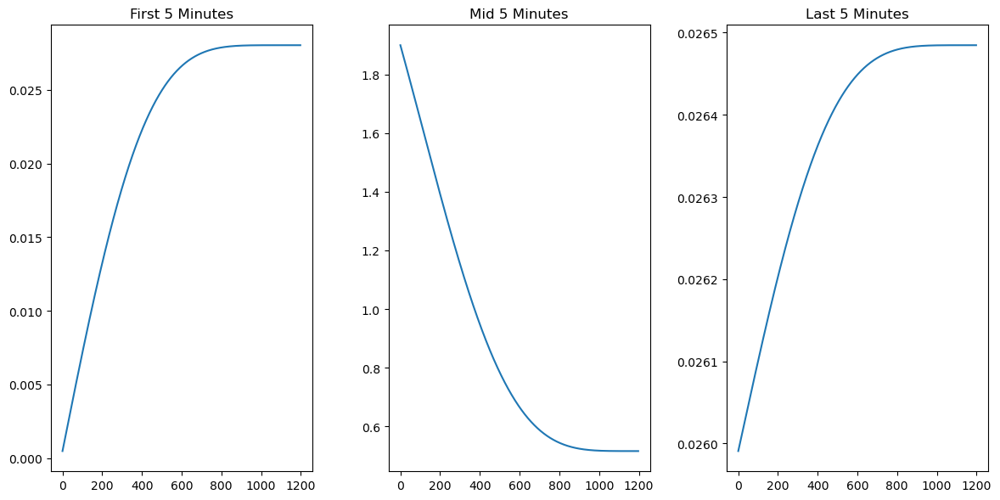

In [71]:
from datetime import datetime
from datetime import timedelta
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from scipy.signal import find_peaks
df= pd.read_excel(open(r'C:\temp\EDA.xlsx','rb'),sheet_name='Sheet1')

EDA_time=df['EDA_time']

eda_data=df['EDA']
# Define start and end timestamps
start_timestamp =EDA_time.iloc[0]  # Replace with your actual start timestamp
end_timestamp = EDA_time.iloc[-1] # Replace with your actual end timestamp

start = pd.to_datetime(start_timestamp, infer_datetime_format=True)
end = pd.to_datetime(end_timestamp, infer_datetime_format=True)

# Calculate the time difference in seconds
time_difference_seconds = (end-start).total_seconds()

T=time_difference_seconds/60
Tw=5
data_points_in_window = int((Tw/T) * len(df))


#first five minutes
First5_end=start+timedelta(minutes=5)

dfs_F= df[(df['EDA_time'] >= start) & (df['EDA_time'] <= First5_end)]


#middle five minutes
mid=T/2
Midtime=start+timedelta(minutes=mid)
Mid5_start=Midtime-timedelta(minutes=2.5)
Mid5_end=Midtime+timedelta(minutes=2.5)
dfs_M= df[(df['EDA_time'] >= Mid5_start) & (df['EDA_time'] <= Mid5_end)]

#last Five minutes
last5_start=end-timedelta(minutes=5)
dfs_l= df[(df['EDA_time'] >= last5_start) & (df['EDA_time'] <= end)]


def apply_trendline(data):
    # Load your EDA data (replace with your actual data)
    eda_data=data['EDA']
    eda_clean1 = nk.eda_clean(eda_data, sampling_rate=4000, method='neurokit')


    # Define the window size for the moving average
    window_size = 3
    # Calculate the moving average
    trendline = np.convolve(eda_clean1, np.ones(window_size)/window_size, mode='valid')
    return trendline

# Apply SC trendline to each segment
trendline_first_five_min = apply_trendline(dfs_F)
trendline_middle_portion = apply_trendline(dfs_M)
trendline_last_five_min = apply_trendline(dfs_l)

# Plot the original EDA data and the extracted trendlines for each segment
plt.figure(figsize=(12, 6))
plt.subplot(131)
plt.title('First 5 Minutes')
plt.plot(trendline_first_five_min)
plt.subplot(132)
plt.title('Mid 5 Minutes')
plt.plot(trendline_middle_portion)
plt.subplot(133)
plt.title('Last 5 Minutes')
plt.plot(trendline_last_five_min)
plt.tight_layout()
plt.show()




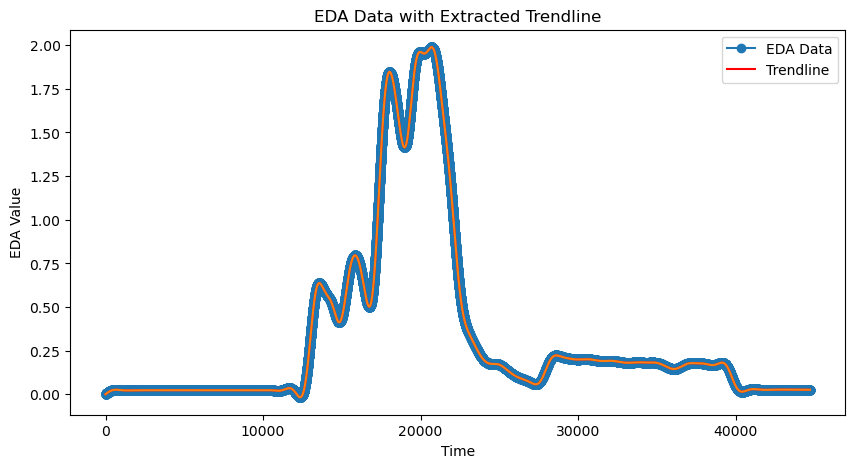

In [46]:
import numpy as np
import matplotlib.pyplot as plt

# Load your EDA data (replace with your actual data)
eda_data =df['EDA']
eda_clean1 = nk.eda_clean(eda_data, sampling_rate=4000, method='neurokit')

# Define the window size for the moving average
window_size = 3

# Calculate the moving average
trendline = np.convolve(eda_clean1, np.ones(window_size)/window_size, mode='valid')
last_5_min_start_index = max(len(sc_trendline) - 5, 0)

# Extract the last 5 minutes of SC data
last_5_min_sc_trendline = sc_trendline[last_5_min_start_index:]

# Plot the original EDA data and the extracted trendline
plt.figure(figsize=(10, 5))
plt.plot(eda_clean1, label='EDA Data', marker='o')
plt.plot(range(window_size-1, len(eda_data)), trendline, label='Trendline', color='red')
plt.legend()
plt.xlabel('Time')
plt.ylabel('EDA Value')
plt.title('EDA Data with Extracted Trendline')
plt.show()

In [22]:
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import accuracy_score

# Sample data for demonstration purposes
# Replace this with your actual data
# features is a list of feature vectors, and scores is a list of participant scores
# where each entry corresponds to an exam
features = [
    [0.023387686,0.934243669,0.026600814,0.001237678,0.680161816,0.001201133,18.68917183],
   [0.011550532,0.249873871,0.013839091,0.001669638,0.072101856,0.001482798,9.841574832],
[0.000850379,0.130801103,0.001940119,0.001580648,0.051671785,0.001026389,46.8737598],
[8.00564E-05,0.191637493,0,0.001014035,0.036947676,02393.781845],
[6.04799E-05,0.180539673,0,0.000968623,0.031448463,0,2985.120226],
[0.592404603,0.592404603,0,0.606093101,0.606093101,0,1],
[0.000927955,0.415723051,0.004254013,0.001645348,0.252098531,0.00120682,80.22494349],
[0.000927955,0.415723051,0.004254013,0.001645348,0.252098531,0.00120682,80.22494349],
[0.01371348,0.314582522,0.014431668,0.001334068,0.049098106,0.001065321,11.17714932],
[0.018946114,0.347755038,0.022450581,0.003416267,0.027171949,0.008553582,8.400550633],

    # Add more exams and feature vectors as needed
]

scores = [78.0,82.0,77.0,75.0,67.0,71.0,64.0,92.0,80.0,89.0]

# Define a function to label scores as 'high' or 'low'
def label_scores(score):
    return 'high' if score >= 80 else 'low'

# Create and train classifiers for each time window for each exam
classifiers = []

for exam_features, exam_scores in zip(features, scores):
    exam_classifiers = []
    
    for Tw_features, score in zip(exam_features, exam_scores):
        X_train, X_test, y_train, y_test = train_test_split(Tw_features, label_scores(score), test_size=0.2, random_state=42)
        
        classifier = DecisionTreeClassifier()  # You can use a different classifier as needed
        classifier.fit(X_train, y_train)
        
        y_pred = classifier.predict(X_test)
        accuracy = accuracy_score(y_test, y_pred)
        print(f"Accuracy for Tw = {Tw} min:", accuracy)
        
        exam_classifiers.append(classifier)
    
    classifiers.append(exam_classifiers)

# You now have a list of classifiers for each exam and each time window.
# You can use these classifiers to predict 'high' or 'low' labels for new feature vectors.


TypeError: 'float' object is not iterable